# UP 206A Final: Nathan Keibler and Bryan Graveline - Part 2

This document series contains our group's code from Group Assignment 3, Group Assignment 4, and new code created for the final project. Section 2 sets up the data sources using mostly code from Group Assignment 3. Section 3 includes the spatial join to connect our two datasets and some inital mapping of the joined geodataframe. Section 4 contains the spatial autocorrelation analysis. Lastly, Section 5 contains a scatter plot and side-by-side map relating neighborhood income to ADUs permitted per capita.

This specific document (Part 2) contains Section 3 as well as data and analysis from Section 2 necessary to inform Section 3.

# Data and Analysis from Section 2 to Inform Section 3

In [1]:
# to read and wrangle data
import pandas as pd
import numpy as np

# to import data from LA Data portal
from sodapy import Socrata

# to create spatial data
import geopandas as gpd

# for basemaps
import contextily as ctx

# For spatial statistics
import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation

import libpysal as lps

# Graphics
import matplotlib.pyplot as plt
import plotly.express as px

/opt/conda/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.1-CAPI-1.13.3) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


In [2]:
df = gpd.read_file('data/Building_and_Safety_Permit_Information_Old_cleaned.csv')

In [3]:
gdf = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.Longitude, df.Latitude))

In [4]:
gdf_2 = gpd.read_file('data/acs2019_5yr_B19013_14000US06037185320.geojson')

In [5]:
gdf_2 = gdf_2.drop([1004])

In [6]:
gdf_2.columns = ['geoid','name','median income','error','geometry']

In [7]:
gdf_3 = gpd.read_file('data/acs2019_5yr_B01003_14000US06037208802.geojson')

In [8]:
gdf_3 = gdf_3.drop([1004])

In [9]:
gdf_3.columns = ['geoid','name','population','poperror','geometry']

In [10]:
gdf_2 = pd.merge(gdf_2, gdf_3, on=['geoid','name','geometry'])

In [11]:
gdf.set_crs(epsg=4326, inplace=True)

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status,Status Date,...,Zone,Occupancy,Floor Area-L.A. Building Code Definition,Census Tract,Council District,Latitude,Longitude,Existing Code,Proposed Code,geometry
0,5069,2,15,TR 4713,,43,20WL05816,19014-10000-05185,Issued,3/10/2020,...,R1R3-RG-O,,115,2169,10,34.04739,-118.36467,7,1,POINT (-118.36467 34.04739)
1,2276,18,28,TR 5822,,316,19VN04144,19016-20001-12927,Permit Finaled,10/28/2020,...,RE11-1,,0,1413.04,4,34.14947,-118.4565,1,1,POINT (-118.45650 34.14947)
2,2226,14,6,TR 20444,,6,20ON 1930,20016-10000-19416,Issued,10/27/2020,...,R1-1,,0,1321.02,6,34.20732,-118.49688,1,1,POINT (-118.49688 34.20732)
3,2637,1,20,TR 14616,,87,19VN92737,19016-20000-10523,CofO Issued,10/31/2020,...,R1-1,,0,1199,6,34.2294,-118.43923,1,1,POINT (-118.43923 34.22940)
4,5053,24,32,CHA'S VICTOR HALL TRACT,26,21,20ON 1938,20010-10000-02259,Issued,10/27/2020,...,R1R3-O-CPIO,,438,2221,8,34.02655,-118.30291,,1,POINT (-118.30291 34.02655)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8663,6031,31,11,SUNSET SQUARE,,20,19SL68122,19010-10000-00417,Issued,10/21/2019,...,R2-1,,"1,088",2397.01,9,33.9649,-118.27552,,1,POINT (-118.27552 33.96490)
8664,2346,20,2,TR 11715,,2,19VN01880,19016-20000-04281,Issued,8/22/2019,...,R1-1,,0,1240,2,34.16792,-118.40928,1,1,POINT (-118.40928 34.16792)
8665,2167,11,6,TR 6170,O,2608,19VN92782,18010-20000-04034,CofO Issued,11/23/2020,...,R1-1,,"1,150",1375.02,3,34.15856,-118.59564,,1,POINT (-118.59564 34.15856)
8666,2336,36,35,TR 5847,A,48,20VN19507,20014-20000-01584,Issued,10/28/2020,...,R1-1,,87,1242.01,2,34.18136,-118.37113,7,1,POINT (-118.37113 34.18136)


In [12]:
gdf_web_mercator = gdf.to_crs(epsg=3857)

# Data Join and Initial Analysis (From Group Assignment 4)

In this section, we (for the first time!) join our two datasets: permitted ADUs and neighorhood income levels. We create a single geodataframe containing information from both datasets and create an initial map.

## Create a two layer map

For the first time, we now combine our two data sources. Below, we create a map showing the census blocks and permitted ADUs. For now, all the census blocks are formatted the same.

In [13]:
# get the bounding box coordinates for the permit data
minx, miny, maxx, maxy = gdf.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-118.66127
-118.1593
33.71678
34.32924


## Subplots for multi-layered maps

In [14]:
gdf = gdf.to_crs(epsg=4326)
gdf_2 = gdf_2.to_crs(epsg=4326)

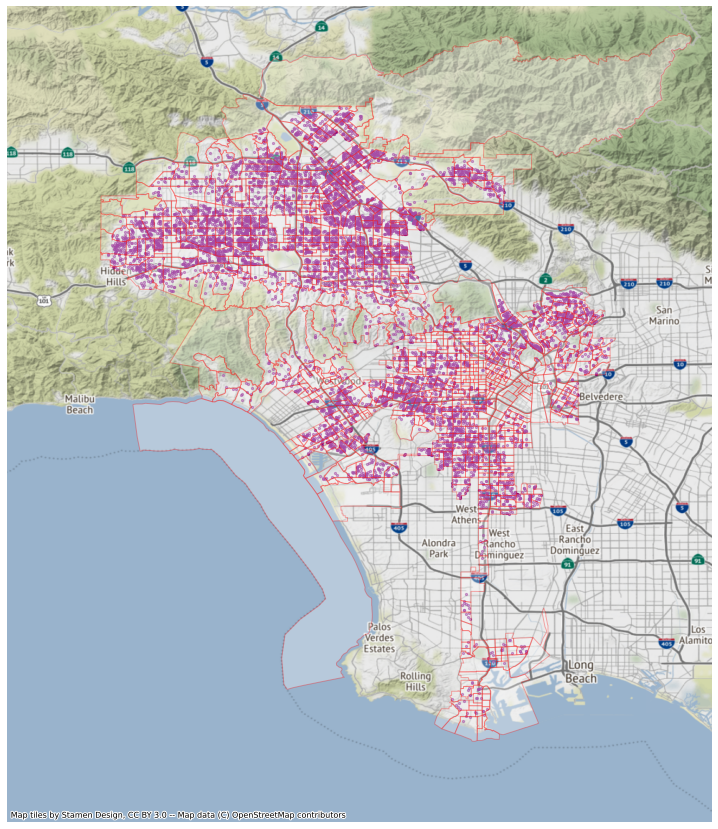

In [15]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(15, 15))

# permit data
gdf.plot(ax=ax, # this also puts it in the same ax plot
            color='purple',
            markersize=5,
            alpha=0.5)

# median income by census tract
gdf_2.plot(ax=ax, # this puts it in the ax plot 
        color='white',
        edgecolor='red',
        alpha=0.3)

# use the bounding box coordinates to set the x and y limits
ax.set_xlim(minx - 0.1, maxx + 0.1) # added/substracted value is to give some margin of 1000 meters (1km) around total bounds
ax.set_ylim(miny - 0.1, maxy + 0.1)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,crs=gdf.crs.to_string())

## The spatial join

In [16]:
# Do the spatial join
gdf = gdf.to_crs(epsg=4326)
join = gpd.sjoin(gdf, gdf_2, how='left')
join.head()

,Assessor Book,Assessor Page,Assessor Parcel,Tract,Block,Lot,Reference # (Old Permit #),PCIS Permit #,Status,Status Date,...,Existing Code,Proposed Code,geometry,index_right,geoid,name,median income,error,population,poperror
0,5069,2,15,TR 4713,,43,20WL05816,19014-10000-05185,Issued,3/10/2020,...,7,1,POINT (-118.36467 34.04739),642,14000US06037216900,"Census Tract 2169, Los Angeles, CA",89547.0,20184.0,4886.0,343.0
1,2276,18,28,TR 5822,,316,19VN04144,19016-20001-12927,Permit Finaled,10/28/2020,...,1,1,POINT (-118.45650 34.14947),336,14000US06037141304,"Census Tract 1413.04, Los Angeles, CA",98375.0,9629.0,2995.0,271.0
2,2226,14,6,TR 20444,,6,20ON 1930,20016-10000-19416,Issued,10/27/2020,...,1,1,POINT (-118.49688 34.20732),262,14000US06037132102,"Census Tract 1321.02, Los Angeles, CA",49838.0,12253.0,5401.0,485.0
3,2637,1,20,TR 14616,,87,19VN92737,19016-20000-10523,CofO Issued,10/31/2020,...,1,1,POINT (-118.43923 34.22940),139,14000US06037119900,"Census Tract 1199, Los Angeles, CA",78000.0,14084.0,5245.0,401.0
4,5053,24,32,CHA'S VICTOR HALL TRACT,26,21,20ON 1938,20010-10000-02259,Issued,10/27/2020,...,,1,POINT (-118.30291 34.02655),687,14000US06037222100,"Census Tract 2221, Los Angeles, CA",53864.0,12608.0,4331.0,488.0


We now have a single geodataframe (titled "join") that shows every permit, along with its census tract, that tract's median income, and that tract's population. We then create a table (permits_by_tract) showing each of the census tracts sorted by how many permits were pulled in them. Below that, we show a table of the top 20 tracts. Without a spatial component, this doesn't tell us a bunch.

In [17]:
#combining arguments (can be split up) to use joined gdf and using the FIPS code to get a count - resetting to get index
permits_by_tract = join.geoid.value_counts().rename_axis('geoid').reset_index(name='permits_count')

In [18]:
permits_by_tract.head(20)

,geoid,permits_count
0,14000US06037135203,53
1,14000US06037181000,52
2,14000US06037139301,51
3,14000US06037119800,49
4,14000US06037121010,48
5,14000US06037131800,47
6,14000US06037211000,44
7,14000US06037122000,43
8,14000US06037123700,41
9,14000US06037135111,40


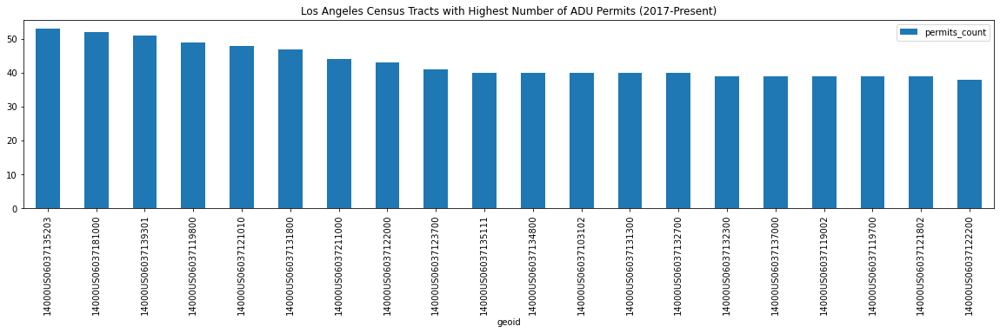

In [19]:
# make a bar chart of top 20 geographies
permits_by_tract[:20].plot.bar(figsize=(20,4), 
                             x='geoid', 
                             y='permits_count', title='Los Angeles Census Tracts with Highest Number of ADU Permits (2017-Present)')

## Join the value counts back to the gdf

We want to add a spatial component, so we begin that process by joining the number of permits in each census tract to our original census tract dataset.

In [20]:
# join the summary table back to the gdf
# merge permits on gdf by census tract
gdf_2=gdf_2.merge(permits_by_tract,on='geoid')

In [21]:
gdf_2.head()

,geoid,name,median income,error,geometry,population,poperror,permits_count
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,16806.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",4283.0,443.0,21
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,9796.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",3405.0,334.0,17
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,9483.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",6347.0,484.0,2
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,4639.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",3702.0,276.0,12
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,11857.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",3884.0,394.0,23


## Normalizing: Permits per 1000 people

Before going any further, though, we want to normalize our permit data based on population. If a census tract has twice the population of another, we don't want to give it extra credit for having more ADU permits.

In [22]:
gdf_2['permits_per_1000'] = gdf_2['permits_count']/gdf_2['population']*1000

In [23]:
gdf_2.head()

,geoid,name,median income,error,geometry,population,poperror,permits_count,permits_per_1000
0,14000US06037101110,"Census Tract 1011.10, Los Angeles, CA",63534.0,16806.0,"MULTIPOLYGON (((-118.30229 34.25870, -118.3009...",4283.0,443.0,21,4.903105
1,14000US06037101122,"Census Tract 1011.22, Los Angeles, CA",90389.0,9796.0,"MULTIPOLYGON (((-118.30334 34.27371, -118.3033...",3405.0,334.0,17,4.992658
2,14000US06037101210,"Census Tract 1012.10, Los Angeles, CA",44083.0,9483.0,"MULTIPOLYGON (((-118.29945 34.25598, -118.2979...",6347.0,484.0,2,0.315110
3,14000US06037101220,"Census Tract 1012.20, Los Angeles, CA",43713.0,4639.0,"MULTIPOLYGON (((-118.28593 34.25227, -118.2859...",3702.0,276.0,12,3.241491
4,14000US06037101300,"Census Tract 1013, Los Angeles, CA",81776.0,11857.0,"MULTIPOLYGON (((-118.27822 34.25068, -118.2782...",3884.0,394.0,23,5.921730


In [24]:
gdf_2.sort_values(by="median income").head(10)

,geoid,name,median income,error,geometry,population,poperror,permits_count,permits_per_1000
562,14000US06037221820,"Census Tract 2218.20, Los Angeles, CA",12235.0,2899.0,"MULTIPOLYGON (((-118.28882 34.03276, -118.2874...",2363.0,484.0,8,3.385527
682,14000US06037242600,"Census Tract 2426, Los Angeles, CA",16586.0,3141.0,"MULTIPOLYGON (((-118.25425 33.93097, -118.2542...",4756.0,435.0,1,0.210261
563,14000US06037221900,"Census Tract 2219, Los Angeles, CA",17237.0,8026.0,"MULTIPOLYGON (((-118.29590 34.02716, -118.2959...",4248.0,529.0,6,1.412429
706,14000US06037265304,"Census Tract 2653.04, Los Angeles, CA",21228.0,3675.0,"MULTIPOLYGON (((-118.45311 34.07059, -118.4530...",2878.0,405.0,1,0.347464
663,14000US06037240300,"Census Tract 2403, Los Angeles, CA",22875.0,3967.0,"MULTIPOLYGON (((-118.29161 33.95335, -118.2916...",5637.0,683.0,5,0.886997
589,14000US06037228900,"Census Tract 2289, Los Angeles, CA",23750.0,11147.0,"MULTIPOLYGON (((-118.24776 33.99484, -118.2455...",2918.0,307.0,2,0.685401
622,14000US06037234902,"Census Tract 2349.02, Los Angeles, CA",23981.0,5049.0,"MULTIPOLYGON (((-118.33855 33.98266, -118.3385...",4088.0,531.0,5,1.223092
556,14000US06037221401,"Census Tract 2214.01, Los Angeles, CA",24904.0,6002.0,"MULTIPOLYGON (((-118.31768 34.03659, -118.3168...",3628.0,443.0,2,0.551268
561,14000US06037221810,"Census Tract 2218.10, Los Angeles, CA",25357.0,3285.0,"MULTIPOLYGON (((-118.29590 34.03274, -118.2953...",2892.0,312.0,5,1.728907
645,14000US06037238310,"Census Tract 2383.10, Los Angeles, CA",26356.0,4332.0,"MULTIPOLYGON (((-118.29165 33.96780, -118.2914...",5002.0,455.0,1,0.199920


It looks like census tract 9800.09 has just 5 residents, but also an ADU. Census tract 9800.26 similarly has just 1 ADU but not many residents. We'll keep an eye on these outliers as we proceed through the data. For this assignment, I don't want to remove any data, but we may consider doing so for the final project. Next, we map a slice of the data, showing the 20 census tracts with the most ADUs permitted per person.

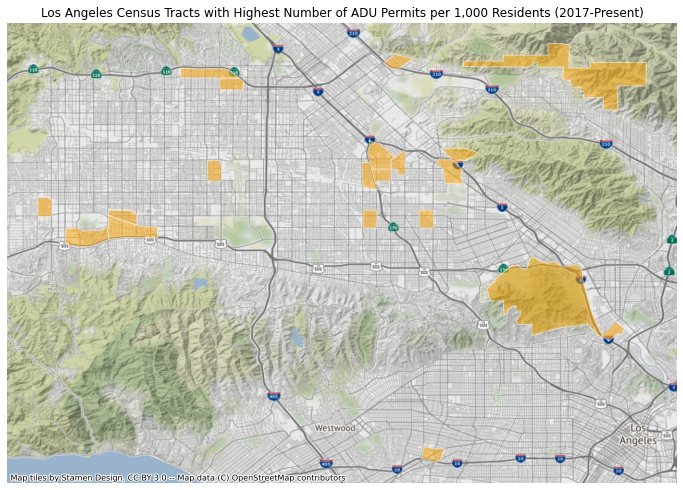

In [25]:
fig,ax = plt.subplots(figsize=(12,10))
gdf_2.sort_values(by='permits_per_1000',ascending=False)[:20].plot(ax=ax,
                                                                 color='orange',
                                                                 edgecolor='white',
                                                                 alpha=0.5,legend=True)


# title
ax.set_title('Los Angeles Census Tracts with Highest Number of ADU Permits per 1,000 Residents (2017-Present)')

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,crs=gdf.crs.to_string())

They're (almost) all in the Valley - that's very interesting. I tend to think of the Valley as having a greater diversity of incomes; I wonder if that has anything to do with it? I'm sure our further analysis will yield more insights.

## Choropleth Map of Permits

Now we are ready to generate a choropleth map of the permitted ADUs.

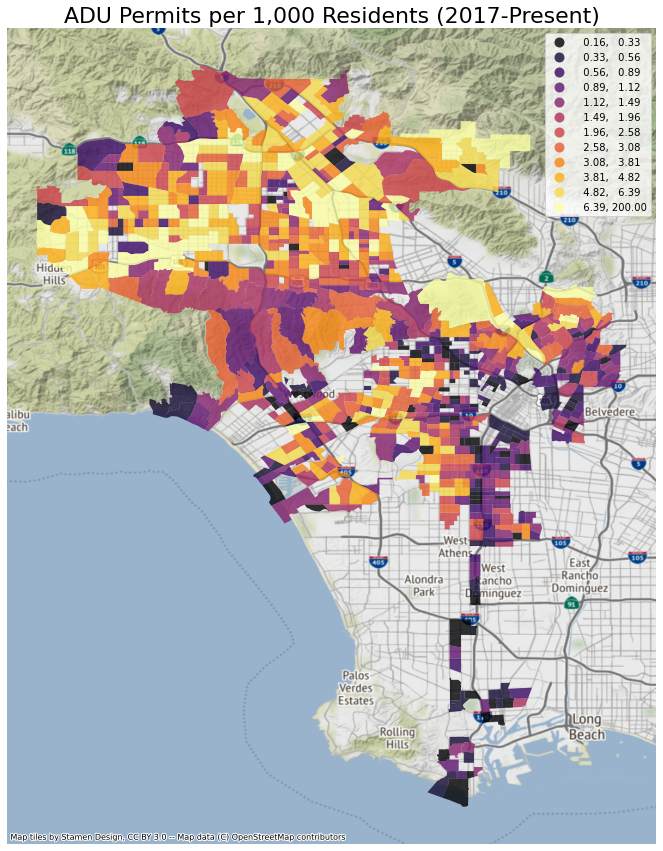

In [26]:
fig, ax = plt.subplots(figsize=(15,15))

gdf_2.plot(ax=ax,
          column='permits_per_1000',
           legend=True,
           alpha = 0.8,
           cmap='inferno',
           k=12,
           scheme='quantiles')

ax.axis('off')
ax.set_title('ADU Permits per 1,000 Residents (2017-Present)',fontsize=22)
ctx.add_basemap(ax,crs=gdf.crs.to_string())

Now here is some interesting data! The trend of the most ADUs per person in the Valley continues. It looks like there are also some ADU activity clusters in West LA. South LA and East LA have less ADUs. The hills also have less ADUs.

The last thing we'll do in this section before moving on  to spatial autocorrelation is to create dynamic choropleth maps of both median income and permitted ADUs per 1,000 residents. For both maps, we'll include labels for both median income and permits per 1000 residents.

In [27]:
# interactive version needs to be in WGS84
gdf_2_web = gdf_2.to_crs('EPSG:4326')

# what's the centroid? (center lat, center long)
minx, miny, maxx, maxy = gdf_2_web.geometry.total_bounds
center_lat_gdf_2_web = (maxy-miny)/2+miny
center_lon_gdf_2_web = (maxx-minx)/2+minx

In [33]:
fig_8 = px.choropleth_mapbox(gdf_2, 
                     geojson=gdf_2.geometry, # the geometry column
                     locations=gdf_2.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='median income',
                     color_continuous_scale='inferno',
                     range_color =(25000,200000),
                     hover_data=['median income','permits_per_1000'],
                     center = {"lat": center_lat_gdf_2_web, "lon": center_lon_gdf_2_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'median income':'Median Income',
                             'permits_per_1000':'Permits per 1000 Residents',
                     })
fig_8.update_traces(marker_line_width=0.1, marker_line_color='white')
fig_8.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

In [29]:
fig_8.write_html("Final_spatial_join_fill_by_income_dynamic_basemap.html")

In [35]:
fig_9 = px.choropleth_mapbox(gdf_2, 
                     geojson=gdf_2.geometry, # the geometry column
                     locations=gdf_2.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='permits_per_1000',
                     color_continuous_scale='inferno',
                     range_color =(0,8),
                     hover_data=['median income','permits_per_1000'],
                     center = {"lat": center_lat_gdf_2_web, "lon": center_lon_gdf_2_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'median income':'Median Income',
                             'permits_per_1000':'Permits per 1000 Residents',
                     })
fig_9.update_traces(marker_line_width=0.1, marker_line_color='white')
fig_9.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

In [31]:
fig_9.write_html("Final_spatial_join_fill_by_permitper1000_dynamic_basemap.html")

From an initial look at this data, it appears that the Valley has the most ADU permits, the west hills area has the highest income, and south LA has low ADUs and low incomes. We will dive further into the relationship between the two datasets in Section 5.